In [24]:
import numpy as np 
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import os
import sys
import re
import pandas as pd 
import glob
import scipy
import scipy.io
from collections import Counter
import scanpy as sc
import gseapy as gp
import h5py
import louvain
import harmonypy as hm
import scrublet as scr
from matplotlib import rcParams
rcParams['figure.figsize'] = 12,12
file_figs = ''
from methods import *
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80)
sc.settings.figdir = '../figures/ec_subtypes/'

-----
anndata     0.7.4
scanpy      1.6.0
sinfo       0.3.1
-----
PIL                 8.0.0
anndata             0.7.4
appdirs             1.4.4
attr                20.3.0
backcall            0.2.0
bioservices         1.7.9
brotli              NA
bs4                 4.9.1
cairo               1.19.1
certifi             2020.12.05
cffi                1.14.0
chardet             3.0.4
colorama            0.4.3
colorlog            NA
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.1
decorator           4.4.2
docutils            0.16
easydev             0.10.1
get_version         2.1
google              NA
gseapy              0.10.1
h5py                2.10.0
harmonypy           NA
html5lib            1.1
idna                2.10
igraph              0.8.2
ipykernel           5.3.4
ipython_genutils    0.2.0
ipywidgets          7.5.1
jedi                0.17.2
jinja2              2.11.2
joblib              0.16.0
jsonschema          3.2.0
kiwisolver          1.2.0
lega

In [25]:
rcParams['font.family'] = 'Arial'

-----
anndata     0.7.4
scanpy      1.6.0
sinfo       0.3.1
-----
PIL                 8.0.0
anndata             0.7.4
appdirs             1.4.4
attr                20.3.0
backcall            0.2.0
bioservices         1.7.9
brotli              NA
bs4                 4.9.1
cairo               1.19.1
certifi             2020.12.05
cffi                1.14.0
chardet             3.0.4
colorama            0.4.3
colorlog            NA
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.1
decorator           4.4.2
docutils            0.16
easydev             0.10.1
get_version         2.1
google              NA
gseapy              0.10.1
h5py                2.10.0
harmonypy           NA
html5lib            1.1
idna                2.10
igraph              0.8.2
ipykernel           5.3.4
ipython_genutils    0.2.0
ipywidgets          7.5.1
jedi                0.17.2
jinja2              2.11.2
joblib              0.16.0
jsonschema          3.2.0
kiwisolver          1.2.0
lega

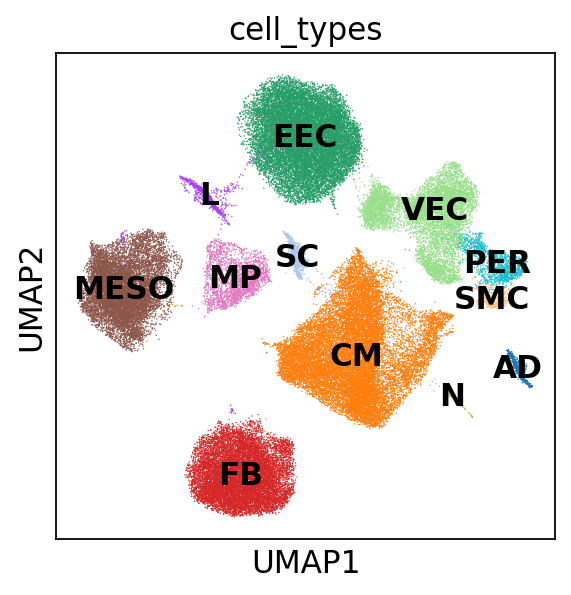

In [26]:
%matplotlib inline
from matplotlib import rcParams
rcParams['figure.figsize'] = 12,12
file_figs = ''
from methods import *
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80)
sc.settings.figdir = '../figures/M2_cell_type/'

adata = sc.read_h5ad("../h5ad/celltypes_60_6000_500_0.1.h5ad")
print(adata)
sc.pl.umap(adata, color = 'cell_types', legend_loc = 'on data')

In [27]:
adata

AnnData object with n_obs × n_vars = 76087 × 10635
    obs: 'n_genes', 'percent_mito', 'n_counts', 'doublet_score', 'batch', 'sample_id', 'phenotype', 'leiden', 'cell_types', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'PCA_corr', 'PCA_cos', 'batch_colors', 'cell_types_colors', 'dendrogram_leiden', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase_colors', 'phenotype_colors', 'rank_genes_groups', 'sample_id_colors', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

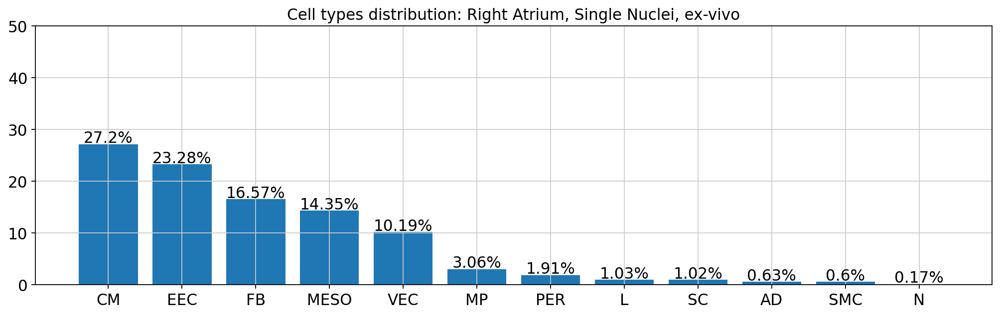

In [5]:
distrib = adata.obs.cell_types.value_counts()
num_cells = adata.obs.shape[0]
cell_types = ['CM', 'EEC', 'FB', 'MESO', 'VEC', 'MP', 'PER', 'L', 'SC', 'AD', 'SMC', 'N']
perc = []
for cell_type  in cell_types:
    if cell_type in list(set(adata.obs.cell_types)):
        perc.append(round(100 * distrib[cell_type] / num_cells, 2))
    else:
        perc.append(0)
rcParams['figure.figsize'] = 12,3.25
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
ax.bar(cell_types,perc)
ymin, ymax = ax.get_ylim()
xmin, xmax = ax.get_xlim()
ax.set(xlim=(xmin, xmax), ylim=(ymin, 50))
ax.set_title('Cell types distribution: Right Atrium, Single Nuclei, ex-vivo')
for i in range(len(cell_types)):
    plt.text(x = i , y = perc[i]+0.3, s = str(perc[i]) + '%', horizontalalignment='center')
plt.show()

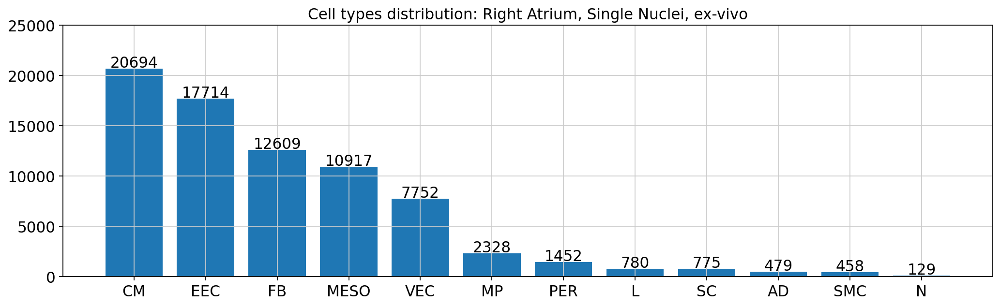

In [19]:
distrib = adata.obs.cell_types.value_counts()
num_cells = adata.obs.shape[0]
cell_types = ['CM', 'EEC', 'FB', 'MESO', 'VEC', 'MP', 'PER', 'L', 'SC', 'AD', 'SMC', 'N']
#cell_types = ['FB', 'CM', 'EEC', 'PER', 'VEC', 'MP', 'L', 'SMC', 'SC', 'AD', 'MESO', 'N']
perc = []
for cell_type  in cell_types:
    if cell_type in list(set(adata.obs.cell_types)):
        perc.append(distrib[cell_type])
    else:
        perc.append(0)
rcParams['figure.figsize'] = 12,3.25
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
ax.bar(cell_types,perc)
ymin, ymax = ax.get_ylim()
xmin, xmax = ax.get_xlim()
ax.set(xlim=(xmin, xmax), ylim=(ymin, 25000))
ax.set_title('Cell types distribution: Right Atrium, Single Nuclei, ex-vivo')
for i in range(len(cell_types)):
    plt.text(x = i , y = perc[i]+150, s = str(perc[i]), horizontalalignment='center')
plt.show()

findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.


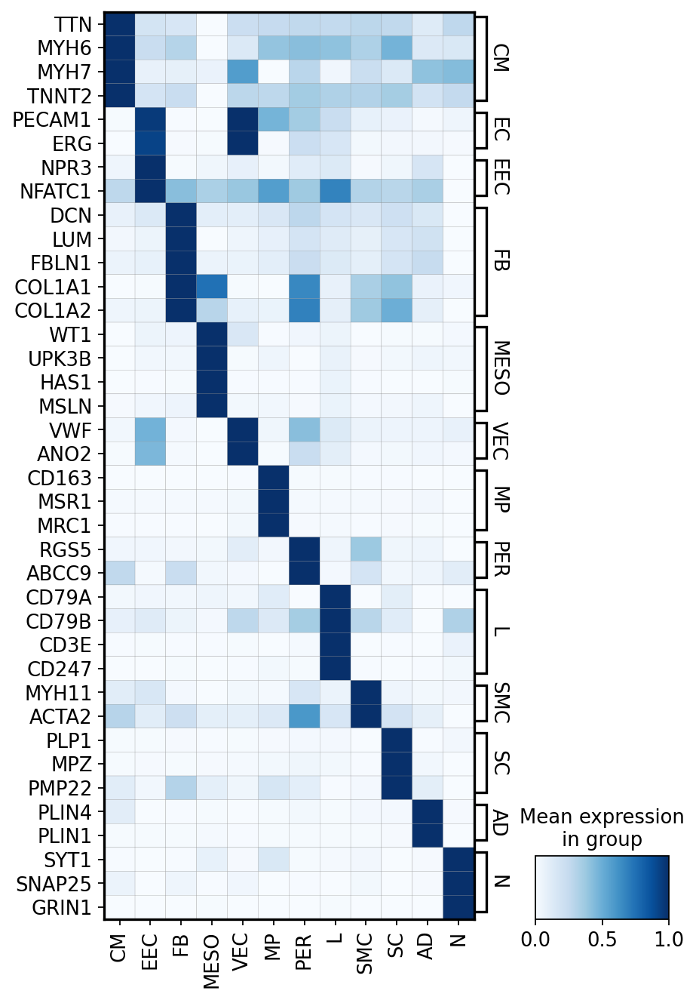

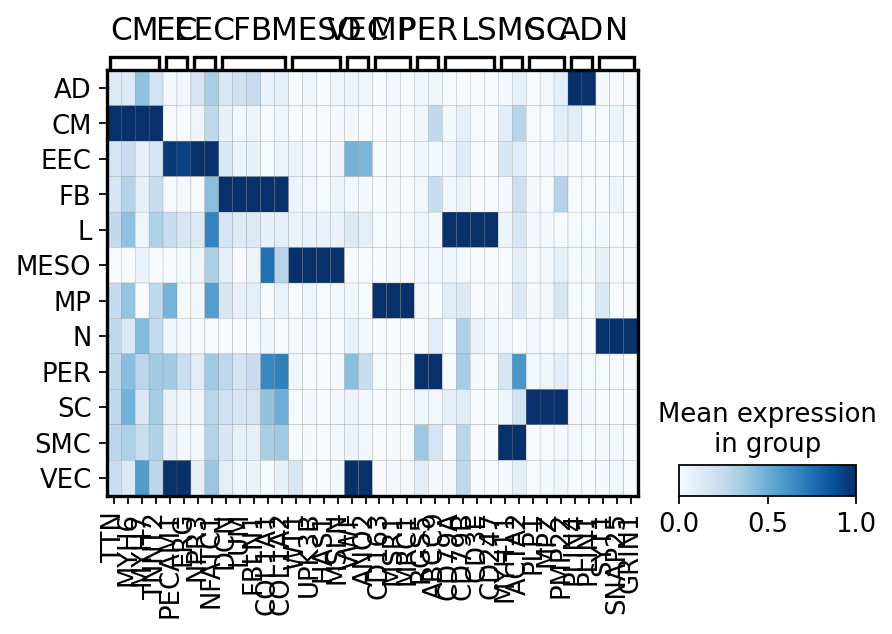

In [9]:
rcParams['figure.figsize'] = 2.5,2.5
markers_all = ["TTN", "MYH6", "MYH7", "TNNT2", 
               "PECAM1", "ERG",
               "NPR3", "NFATC1", 
               "DCN", "LUM", "FBLN1", "COL1A1", "COL1A2",
               'WT1', 'UPK3B', 'HAS1', 'MSLN',
               "VWF", "ANO2",
               "CD163", "MSR1", "MRC1", 
               "RGS5", "ABCC9",
               'CD79A', 'CD79B', 'CD3E', 'CD247',
               "MYH11", "ACTA2",
               'PLP1', 'MPZ', 'PMP22',
               "PLIN4", "PLIN1",
               'SYT1', 'SNAP25', 'GRIN1']
markers_groups = [(0,3), (4,5), (6,7), (8, 12), (13,16), (17,18), (19,21), (22, 23), (24, 27), 
                  (28, 29), (30, 32), (33, 34), (35, 37)]
markers_groups_names = ['CM', 'EC', 'EEC', 'FB', 'MESO', 'VEC', 'MP', 'PER', 'L', 'SMC', 'SC', 'AD', 'N']
order_cat = ['CM', 'EEC', 'FB', 'MESO', 'VEC', 'MP', 'PER', 'L', 'SMC', 'SC', 'AD', 'N']
#sc.pl.matrixplot(adata, markers_all, groupby = "cell_types", use_raw = True, 
#                 standard_scale = "var", var_group_positions = markers_groups, 
#                 var_group_labels = markers_groups_names, swap_axes = True,
#                 cmap = "Blues", save="heatmap.pdf", var_group_rotation = 25)
sc.pl.matrixplot(adata, markers_all, groupby = "cell_types", use_raw = True, 
                 standard_scale = "var", var_group_positions = markers_groups, categories_order = order_cat,
                 var_group_labels = markers_groups_names, swap_axes = True, var_group_rotation = 0,
                 cmap = "Blues", save="heatmap.svg", figsize = (6,9.5))
sc.pl.matrixplot(adata, markers_all, groupby = "cell_types", use_raw = True, 
                 standard_scale = "var", var_group_positions = markers_groups, 
                 var_group_labels = markers_groups_names,
                 cmap = "Blues", save="heatmap2.svg", figsize = (6,3.5))
#sc.pl.dotplot(adata, markers_all, groupby = "cell_types_full", use_raw = True, 
#                 standard_scale = "var", var_group_positions = markers_groups, 
#                 var_group_labels = markers_groups_names)
#sc.pl.dotplot(adata, markers_all, groupby = "cell_types_full", use_raw = True, 
#                 var_group_positions = markers_groups, 
#                 var_group_labels = markers_groups_names)

Condition: Right Atrium, Single Nuclei - Ex vivo
Num of samples: 13, Num of cell: 76087


findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.


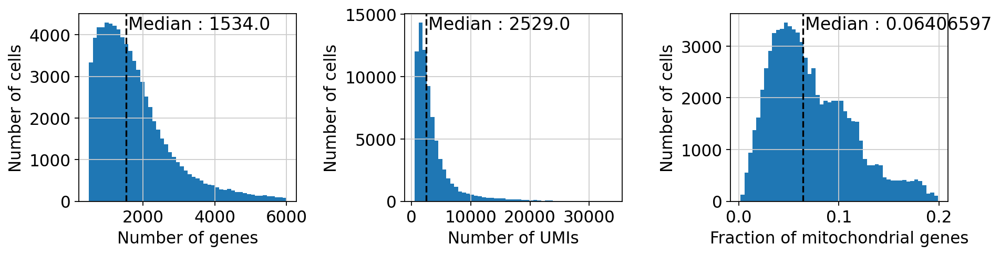

In [6]:
print('Condition: Right Atrium, Single Nuclei - Ex vivo')
print('Num of samples: {}, Num of cell: {}'.format(13, adata.obs.shape[0]))
rcParams['figure.figsize'] = 12,3.25
num_bins = 50
fig, (ax1, ax2, ax3) = plt.subplots(1, 3)

ax1.hist(adata.obs.n_genes, num_bins)
ax1.set_xlabel('Number of genes')
ax1.set_ylabel('Number of cells')
ax1.locator_params(nbins=5, axis='x')
ax1.axvline(adata.obs.n_genes.median(), ls='--', color='black')
ymin, ymax = ax1.get_ylim()
xmin, xmax = ax1.get_xlim()
ax1.text(adata.obs.n_genes.median() + xmax / 100, ymax - ymax / 100, "Median : " + str(adata.obs.n_genes.median()), fontsize=15,
            verticalalignment="top")


ax2.hist(adata.obs.n_counts, num_bins)
ax2.set_xlabel('Number of UMIs')
ax2.set_ylabel('Number of cells')
ax2.locator_params(nbins=5, axis='x')
ax2.axvline(adata.obs.n_counts.median(), ls='--', color='black')
ymin, ymax = ax2.get_ylim()
xmin, xmax = ax2.get_xlim()
ax2.text(adata.obs.n_counts.median() + xmax / 100, ymax - ymax / 100, "Median : " + str(adata.obs.n_counts.median()), fontsize=15,
            verticalalignment="top")

ax3.hist(adata.obs.percent_mito, num_bins)
ax3.set_xlabel('Fraction of mitochondrial genes')
ax3.set_ylabel('Number of cells')
ax3.axvline(adata.obs.percent_mito.median(), ls='--', color='black')
ymin, ymax = ax3.get_ylim()
xmin, xmax = ax3.get_xlim()
ax3.text(adata.obs.percent_mito.median() + xmax / 100, ymax - ymax / 100, "Median : " + str(adata.obs.percent_mito.median()), fontsize=15,
            verticalalignment="top")

fig.tight_layout()

In [18]:
genes_celltypes = ['TTN (Cardiomyocytes)', 'NPR3 (Endocardial EC)', 'DCN (Fibroblasts)', 'MSLN (Mesothelial)',
    'VWF (Vascular EC)', 'MRC1 (Macrophages)', 'RGS5 (Pericytes)', 'CD247 (Lymphocytes)',
    'PMP22 (Schwann cells)', 'PLIN1 (Adipocytes)', 'MYH11 (Smooth muscle)', 'SYT1 (Neurons)']

In [8]:
import random

In [11]:
import random
to_sel = random.sample(adata.obs.index.to_list(), 28197)
adata = adata[adata.obs.index.isin(to_sel)]
sc.tl.pca(adata, svd_solver='arpack')
ho = hm.run_harmony(adata.obsm['X_pca'], adata.obs, "sample_id", max_iter_kmeans=50)
adata.obsm['X_pca'] = ho.Z_corr.T
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=40)
sc.tl.umap(adata)
sc.tl.leiden(adata, resolution = 1)

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:14)


2021-04-30 13:02:04,180 - harmonypy - INFO - Iteration 1 of 10
2021-04-30 13:02:31,641 - harmonypy - INFO - Iteration 2 of 10
2021-04-30 13:02:59,067 - harmonypy - INFO - Iteration 3 of 10
2021-04-30 13:03:15,649 - harmonypy - INFO - Iteration 4 of 10
2021-04-30 13:03:22,656 - harmonypy - INFO - Converged after 4 iterations


computing neighbors
    using 'X_pca' with n_pcs = 40


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 6103. The TBB threading layer is disabled.
  warnings.warn(problem)


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:11)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:21)
running Leiden clustering
    finished: found 19 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)


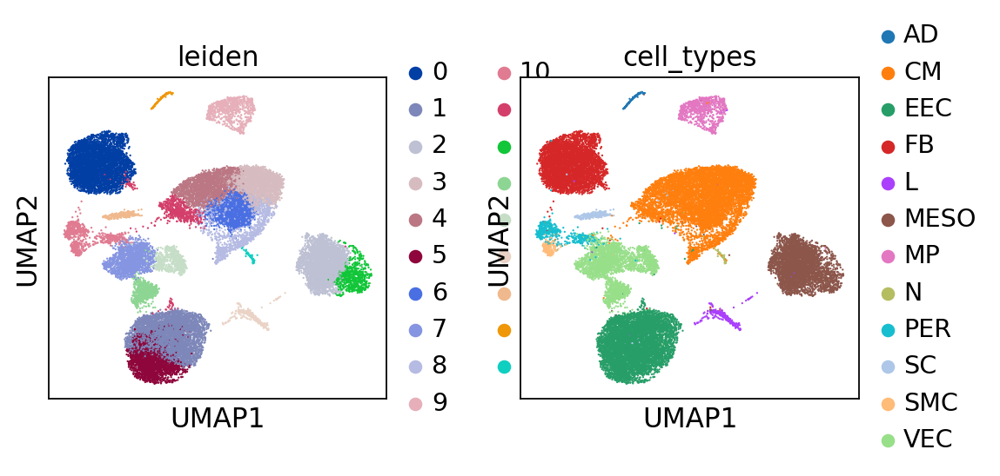

In [15]:
sc.pl.umap(adata, color = ["leiden", "cell_types"])

In [19]:
rcParams['figure.figsize'] = 3,3
genes = ["TTN", "NPR3", "DCN", "MSLN", "VWF", "MRC1", "RGS5", "CD247", "PMP22", "PLIN1", "MYH11", "SYT1"]

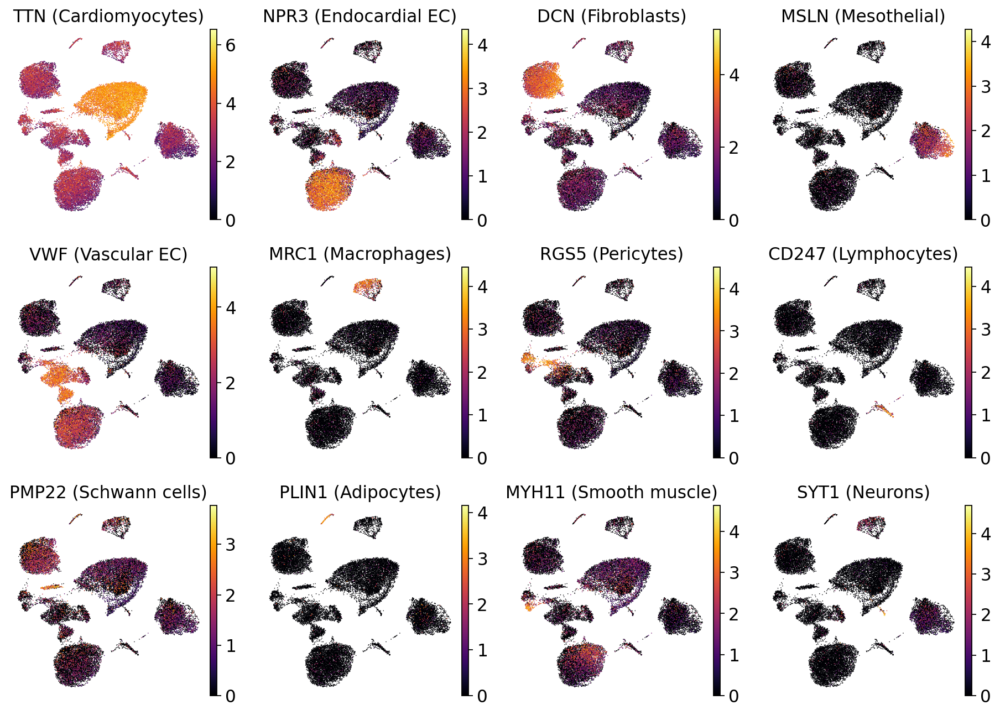

In [20]:
rcParams['figure.figsize'] = 3,3
sc.pl.umap(adata, color = genes, title = genes_celltypes, frameon = False, 
                 color_map = "inferno", wspace = 0.15, size = 2)

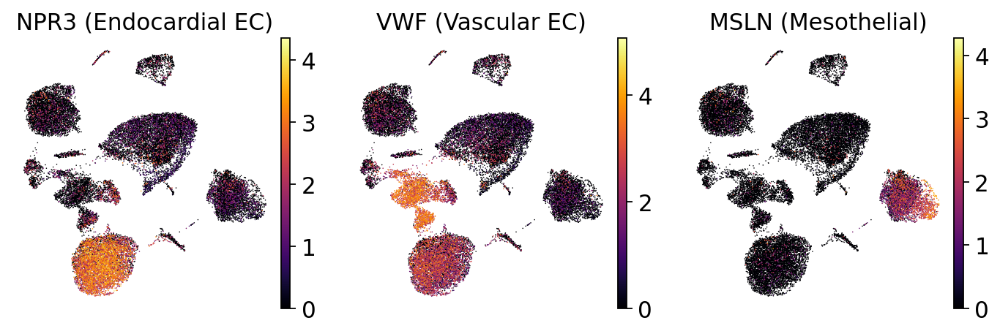

In [22]:
genes = ["NPR3", "VWF", "MSLN"]
genes_celltypes = ['NPR3 (Endocardial EC)', 'VWF (Vascular EC)', 'MSLN (Mesothelial)']
rcParams['figure.figsize'] = 3,3
sc.pl.umap(adata, color = genes, title = genes_celltypes, frameon = False, 
                 color_map = "inferno", wspace = 0.15, size = 2)

In [23]:
adata.write_h5ad("../h5ad/subset_adata_all.h5ad")

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


View of AnnData object with n_obs × n_vars = 7752 × 10635
    obs: 'n_genes', 'percent_mito', 'n_counts', 'doublet_score', 'batch', 'sample_id', 'phenotype', 'leiden', 'cell_types', 'S_score', 'G2M_score', 'phase', 'old_leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'PCA_corr', 'PCA_cos', 'batch_colors', 'cell_types_colors', 'dendrogram_leiden', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase_colors', 'phenotype_colors', 'rank_genes_groups', 'sample_id_colors', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'


Trying to set attribute `.var` of view, copying.


ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:18)
AnnData object with n_obs × n_vars = 7752 × 10635
    obs: 'n_genes', 'percent_mito', 'n_counts', 'doublet_score', 'batch', 'sample_id', 'phenotype', 'leiden', 'cell_types', 'S_score', 'G2M_score', 'phase', 'old_leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std', 'rps', 'rpl', 'mt', 'cm'
    uns: 'PCA_corr', 'PCA_cos', 'batch_colors', 'cell_types_colors', 'dendrogram_leiden', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase_colors', 'phenotype_colors', 'rank_genes_groups', 'sample_id_colors', 'umap'
    obsm: 'X_

2021-01-27 08:46:18,013 - harmonypy - INFO - Iteration 1 of 10
2021-01-27 08:46:24,059 - harmonypy - INFO - Iteration 2 of 10
2021-01-27 08:46:30,110 - harmonypy - INFO - Iteration 3 of 10
2021-01-27 08:46:32,595 - harmonypy - INFO - Iteration 4 of 10
2021-01-27 08:46:35,674 - harmonypy - INFO - Iteration 5 of 10
2021-01-27 08:46:37,474 - harmonypy - INFO - Iteration 6 of 10
2021-01-27 08:46:38,582 - harmonypy - INFO - Iteration 7 of 10
2021-01-27 08:46:39,685 - harmonypy - INFO - Iteration 8 of 10
2021-01-27 08:46:40,557 - harmonypy - INFO - Iteration 9 of 10
2021-01-27 08:46:41,547 - harmonypy - INFO - Iteration 10 of 10
2021-01-27 08:46:42,422 - harmonypy - INFO - Stopped before convergence


computing neighbors
    using 'X_pca' with n_pcs = 40


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 6103. The TBB threading layer is disabled.
  warnings.warn(problem)


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:04)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:17)
running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.


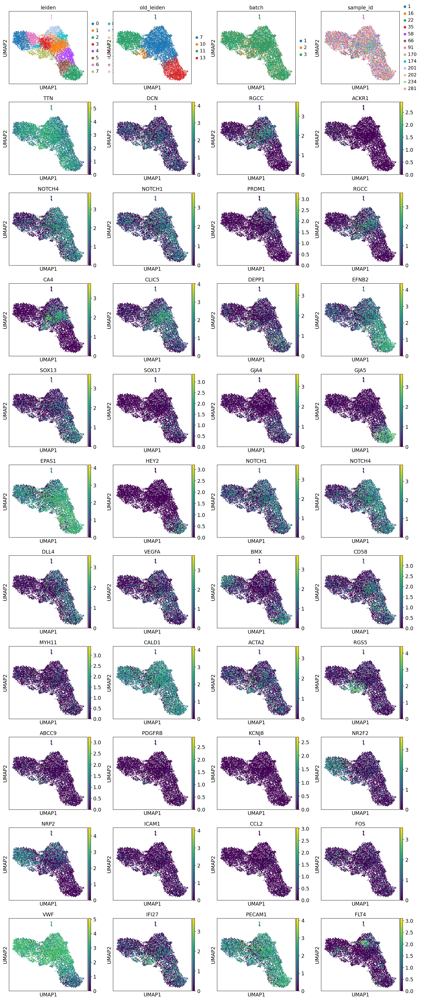

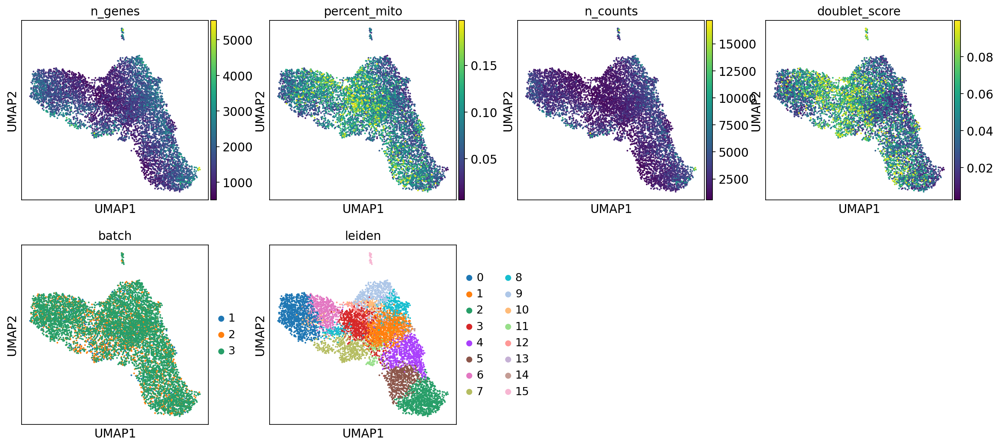

In [15]:
adata.obs['old_leiden'] = adata.obs.leiden
subadata = adata[adata.obs.cell_types.isin(['VEC'])]
#subraw = sc.AnnData(subadata.raw.X.toarray(), var = subadata.raw.var, obs = subadata.obs)
#print(subraw)
#sc.pp.highly_variable_genes(subraw, min_mean=0.005, max_mean=5, min_disp=-0.25)
rcParams['figure.figsize'] = 5,5
#sc.pl.highly_variable_genes(subraw)
#subraw.raw = subraw
#subraw = subraw[:, subraw.var.highly_variable]
#print(subraw)
#subadata = subraw
print(subadata)

subadata.var['rps'] = subadata.var_names.str.startswith('RPS')
subadata.var['rpl'] = subadata.var_names.str.startswith('RPL')
subadata.var['mt'] = subadata.var_names.str.startswith('MT-')
sc.tl.rank_genes_groups(adata, 'cell_types', method='t-test', n_genes = 1000)
df = pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(1000)
#print(list(df.loc[0:500, 'CM']))
subadata.var['cm'] = subadata.var_names.isin(list(df.loc[0:999, 'CM']))

#subadata = subadata[:,~(subadata.var['cm'] | subadata.var['rps'] | subadata.var['rpl'] | subadata.var['mt'])]
#subadata = subadata[:,subadata.var.index.isin(subraw.var.index)]
print(subadata)
#sc.pp.regress_out(subadata, ['n_counts', 'percent_mito'])
#sc.pp.scale(subadata, max_value=10)
sc.tl.pca(subadata, svd_solver='arpack')
ho = hm.run_harmony(subadata.obsm['X_pca'], subadata.obs, "sample_id", max_iter_kmeans=50)
subadata.obsm['X_pca'] = ho.Z_corr.T
sc.pp.neighbors(subadata, n_neighbors=10, n_pcs=40)
sc.tl.umap(subadata)
sc.tl.leiden(subadata, resolution = 1)
rcParams['figure.figsize'] = 4,4
sc.pl.umap(subadata, color=['leiden', 'old_leiden', 'batch', 'sample_id', 'TTN', 'DCN', 'RGCC', 'ACKR1', 
               'NOTCH4', 'NOTCH1', 'PRDM1',
               'RGCC', 'CA4', 'CLIC5',
               "DEPP1", "EFNB2", "SOX13", "SOX17", "GJA4", "GJA5", "EPAS1", "HEY2", "NOTCH1"
                         ,"NOTCH4", "DLL4", "VEGFA", "BMX", "CD58",
               "MYH11", "CALD1", "ACTA2", 
               "RGS5", "ABCC9", "PDGFRB", "KCNJ8",
               'NR2F2', 'NRP2', 'ICAM1', 'CCL2', 'FOS',
              "VWF", "IFI27", "PECAM1", 'FLT4'])
sc.pl.umap(subadata, color = ['n_genes', 'percent_mito', 'n_counts', 'doublet_score', 'batch', 'leiden'])

In [16]:
import collections.abc as cabc
from typing import Union, Optional, Sequence, Any, Mapping, List, Tuple, Callable

import numpy as np
from anndata import AnnData
from cycler import Cycler
from matplotlib.axes import Axes
from matplotlib.figure import Figure
from pandas.api.types import is_categorical_dtype
from matplotlib import pyplot as pl, colors
from matplotlib import rcParams
from matplotlib import patheffects
from matplotlib.colors import Colormap
from functools import partial

from scanpy.plotting import _utils
from scanpy.plotting._utils import (
    _IGraphLayout,
    _FontWeight,
    _FontSize,
    circles,
    make_projection_available,
)

from scanpy import logging as logg
from scanpy._settings import settings
from scanpy._utils import sanitize_anndata, _doc_params, Empty, _empty
from scanpy._compat import Literal

VMinMax = Union[str, float, Callable[[Sequence[float]], float]]

def embedding(
    adata: AnnData,
    basis: str,
    *,
    color: Union[str, Sequence[str], None] = None,
    gene_symbols: Optional[str] = None,
    use_raw: Optional[bool] = None,
    sort_order: bool = True,
    edges: bool = False,
    edges_width: float = 0.1,
    edges_color: Union[str, Sequence[float], Sequence[str]] = 'grey',
    neighbors_key: Optional[str] = None,
    arrows: bool = False,
    arrows_kwds: Optional[Mapping[str, Any]] = None,
    groups: Optional[str] = None,
    components: Union[str, Sequence[str]] = None,
    layer: Optional[str] = None,
    projection: Literal['2d', '3d'] = '2d',
    # image parameters
    img_key: Optional[str] = None,
    crop_coord: Tuple[int, int, int, int] = None,
    alpha_img: float = 1.0,
    bw: bool = False,
    library_id: str = None,
    #
    color_map: Union[Colormap, str, None] = None,
    palette: Union[str, Sequence[str], Cycler, None] = None,
    size: Union[float, Sequence[float], None] = None,
    frameon: Optional[bool] = None,
    legend_fontsize: Union[int, float, _FontSize, None] = None,
    legend_fontweight: Union[int, _FontWeight] = 'bold',
    legend_loc: str = 'right margin',
    legend_fontoutline: Optional[int] = None,
    vmax: Union[VMinMax, Sequence[VMinMax], None] = None,
    vmin: Union[VMinMax, Sequence[VMinMax], None] = None,
    add_outline: Optional[bool] = False,
    outline_width: Tuple[float, float] = (0.3, 0.05),
    outline_color: Tuple[str, str] = ('black', 'white'),
    ncols: int = 4,
    hspace: float = 0.25,
    wspace: Optional[float] = None,
    title: Union[str, Sequence[str], None] = None,
    show: Optional[bool] = None,
    save: Union[bool, str, None] = None,
    ax: Optional[Axes] = None,
    return_fig: Optional[bool] = None,
    show_legend = True,
    **kwargs,
) -> Union[Figure, Axes, None]:
    """\
    Scatter plot for user specified embedding basis (e.g. umap, pca, etc)
    Parameters
    ----------
    basis
        Name of the `obsm` basis to use.
    {adata_color_etc}
    {edges_arrows}
    {scatter_bulk}
    {show_save_ax}
    Returns
    -------
    If `show==False` a :class:`~matplotlib.axes.Axes` or a list of it.
    """

    sanitize_anndata(adata)
    if color_map is not None:
        kwargs['cmap'] = color_map
    if size is not None:
        kwargs['s'] = size
    if 'edgecolor' not in kwargs:
        # by default turn off edge color. Otherwise, for
        # very small sizes the edge will not reduce its size
        # (https://github.com/theislab/scanpy/issues/293)
        kwargs['edgecolor'] = 'none'

    if groups:
        if isinstance(groups, str):
            groups = [groups]

    make_projection_available(projection)
    args_3d = dict(projection='3d') if projection == '3d' else {}

    # Deal with Raw
    if use_raw is None:
        # check if adata.raw is set
        use_raw = layer is None and adata.raw is not None
    if use_raw and layer is not None:
        raise ValueError(
            "Cannot use both a layer and the raw representation. Was passed:"
            f"use_raw={use_raw}, layer={layer}."
        )

    if wspace is None:
        #  try to set a wspace that is not too large or too small given the
        #  current figure size
        wspace = 0.75 / rcParams['figure.figsize'][0] + 0.02
    if adata.raw is None and use_raw:
        raise ValueError(
            "`use_raw` is set to True but AnnData object does not have raw. "
            "Please check."
        )
    # turn color into a python list
    color = [color] if isinstance(color, str) or color is None else list(color)
    if title is not None:
        # turn title into a python list if not None
        title = [title] if isinstance(title, str) else list(title)

    # get the points position and the components list
    # (only if components is not None)
    data_points, components_list = sc.pl._tools.scatterplots._get_data_points(
        adata, basis, projection, components, img_key, library_id
    )

    # Setup layout.
    # Most of the code is for the case when multiple plots are required
    # 'color' is a list of names that want to be plotted.
    # Eg. ['Gene1', 'louvain', 'Gene2'].
    # component_list is a list of components [[0,1], [1,2]]
    if (
        not isinstance(color, str)
        and isinstance(color, cabc.Sequence)
        and len(color) > 1
    ) or len(components_list) > 1:
        if ax is not None:
            raise ValueError(
                "Cannot specify `ax` when plotting multiple panels "
                "(each for a given value of 'color')."
            )
        if len(components_list) == 0:
            components_list = [None]

        # each plot needs to be its own panel
        num_panels = len(color) * len(components_list)
        fig, grid = sc.pl._tools.scatterplots._panel_grid(hspace, wspace, ncols, num_panels)
    else:
        if len(components_list) == 0:
            components_list = [None]
        grid = None
        if ax is None:
            fig = pl.figure()
            ax = fig.add_subplot(111, **args_3d)

    # turn vmax and vmin into a sequence
    if isinstance(vmax, str) or not isinstance(vmax, cabc.Sequence):
        vmax = [vmax]
    if isinstance(vmin, str) or not isinstance(vmin, cabc.Sequence):
        vmin = [vmin]

    if 's' in kwargs:
        size = kwargs.pop('s')

    if size is not None:
        # check if size is any type of sequence, and if so
        # set as ndarray
        import pandas.core.series

        if (
            size is not None
            and isinstance(
                size, (cabc.Sequence, pandas.core.series.Series, np.ndarray,)
            )
            and len(size) == adata.shape[0]
        ):
            size = np.array(size, dtype=float)
    else:
        size = 120000 / adata.shape[0]

    ###
    # make the plots
    axs = []
    import itertools

    idx_components = range(len(components_list))

    # use itertools.product to make a plot for each color and for each component
    # For example if color=[gene1, gene2] and components=['1,2, '2,3'].
    # The plots are: [
    #     color=gene1, components=[1,2], color=gene1, components=[2,3],
    #     color=gene2, components = [1, 2], color=gene2, components=[2,3],
    # ]
    for count, (value_to_plot, component_idx) in enumerate(
        itertools.product(color, idx_components)
    ):
        color_vector, categorical = sc.pl._tools.scatterplots._get_color_values(
            adata,
            value_to_plot,
            layer=layer,
            groups=groups,
            palette=palette,
            use_raw=use_raw,
            gene_symbols=gene_symbols,
        )

        # check if higher value points should be plot on top
        if sort_order is True and value_to_plot is not None and categorical is False:
            order = np.argsort(color_vector)
            color_vector = color_vector[order]
            _data_points = data_points[component_idx][order, :]

            # check if 'size' is given (stored in kwargs['s']
            # and reorder it.
            if isinstance(size, np.ndarray):
                size = np.array(size)[order]
        else:
            _data_points = data_points[component_idx]

        # if plotting multiple panels, get the ax from the grid spec
        # else use the ax value (either user given or created previously)
        if grid:
            ax = pl.subplot(grid[count], **args_3d)
            axs.append(ax)
        if not (settings._frameon if frameon is None else frameon):
            ax.axis('off')
        if title is None:
            if value_to_plot is not None:
                ax.set_title(value_to_plot)
            else:
                ax.set_title('')
        else:
            try:
                ax.set_title(title[count])
            except IndexError:
                logg.warning(
                    "The title list is shorter than the number of panels. "
                    "Using 'color' value instead for some plots."
                )
                ax.set_title(value_to_plot)

        # check vmin and vmax options
        if categorical:
            kwargs['vmin'] = kwargs['vmax'] = None
        else:
            kwargs['vmin'], kwargs['vmax'] = sc.pl._tools.scatterplots._get_vmin_vmax(
                vmin, vmax, count, color_vector
            )

        # make the scatter plot
        if projection == '3d':
            cax = ax.scatter(
                _data_points[:, 0],
                _data_points[:, 1],
                _data_points[:, 2],
                marker=".",
                c=color_vector,
                rasterized=settings._vector_friendly,
                **kwargs,
            )
        else:
            if img_key is not None:
                # had to return size_spot cause spot size is set according
                # to the image to be plotted
                img_processed, img_coord, size_spot, cmap_img = _process_image(
                    adata, data_points, img_key, crop_coord, size, library_id, bw
                )
                ax.imshow(img_processed, cmap=cmap_img, alpha=alpha_img)
                ax.set_xlim(img_coord[0], img_coord[1])
                ax.set_ylim(img_coord[3], img_coord[2])
            elif img_key is None and library_id is not None:
                # order of magnitude similar to public visium
                size_spot = 70 * size

            scatter = (
                partial(ax.scatter, s=size)
                if library_id is None
                else partial(circles, s=size_spot, ax=ax)
            )

            if add_outline:
                # the default outline is a black edge followed by a
                # thin white edged added around connected clusters.
                # To add an outline
                # three overlapping scatter plots are drawn:
                # First black dots with slightly larger size,
                # then, white dots a bit smaller, but still larger
                # than the final dots. Then the final dots are drawn
                # with some transparency.

                bg_width, gap_width = outline_width
                point = np.sqrt(size)
                gap_size = (point + (point * gap_width) * 2) ** 2
                bg_size = (np.sqrt(gap_size) + (point * bg_width) * 2) ** 2
                # the default black and white colors can be changes using
                # the contour_config parameter
                bg_color, gap_color = outline_color

                # remove edge from kwargs if present
                # because edge needs to be set to None
                kwargs['edgecolor'] = 'none'

                # remove alpha for outline
                alpha = kwargs.pop('alpha') if 'alpha' in kwargs else None

                ax.scatter(
                    _data_points[:, 0],
                    _data_points[:, 1],
                    s=bg_size,
                    marker=".",
                    c=bg_color,
                    rasterized=settings._vector_friendly,
                    **kwargs,
                )
                ax.scatter(
                    _data_points[:, 0],
                    _data_points[:, 1],
                    s=gap_size,
                    marker=".",
                    c=gap_color,
                    rasterized=settings._vector_friendly,
                    **kwargs,
                )
                # if user did not set alpha, set alpha to 0.7
                kwargs['alpha'] = 0.7 if alpha is None else alpha

            if groups:
                # first plot non-groups and then plot the
                # required groups on top

                in_groups = np.array(adata.obs[value_to_plot].isin(groups))

                if isinstance(size, np.ndarray):
                    in_groups_size = size[in_groups]
                    not_in_groups_size = size[~in_groups]
                elif img_key is not None:
                    in_groups_size = not_in_groups_size = size_spot
                else:
                    in_groups_size = not_in_groups_size = size

                # only show grey points if no image is below
                if library_id is None:
                    ax.scatter(
                        _data_points[~in_groups, 0],
                        _data_points[~in_groups, 1],
                        s=not_in_groups_size,
                        marker=".",
                        c=color_vector[~in_groups],
                        rasterized=settings._vector_friendly,
                        **kwargs,
                    )
                cax = scatter(
                    _data_points[in_groups, 0],
                    _data_points[in_groups, 1],
                    s=in_groups_size,
                    marker=".",
                    c=color_vector[in_groups],
                    rasterized=settings._vector_friendly,
                    **kwargs,
                )

            else:
                cax = scatter(
                    _data_points[:, 0],
                    _data_points[:, 1],
                    marker=".",
                    c=color_vector,
                    rasterized=settings._vector_friendly,
                    **kwargs,
                )

        # remove y and x ticks
        ax.set_yticks([])
        ax.set_xticks([])
        if projection == '3d':
            ax.set_zticks([])

        # set default axis_labels
        name = sc.pl._tools.scatterplots._basis2name(basis)
        if components is not None:
            axis_labels = [name + str(x + 1) for x in components_list[component_idx]]
        elif projection == '3d':
            axis_labels = [name + str(x + 1) for x in range(3)]

        else:
            axis_labels = [name + str(x + 1) for x in range(2)]

        ax.set_xlabel(axis_labels[0])
        ax.set_ylabel(axis_labels[1])
        if projection == '3d':
            # shift the label closer to the axis
            ax.set_zlabel(axis_labels[2], labelpad=-7)
        ax.autoscale_view()

        if edges:
            _utils.plot_edges(ax, adata, basis, edges_width, edges_color, neighbors_key)
        if arrows:
            _utils.plot_arrows(ax, adata, basis, arrows_kwds)

        if value_to_plot is None:
            # if only dots were plotted without an associated value
            # there is not need to plot a legend or a colorbar
            continue

        if legend_fontoutline is not None:
            path_effect = [
                patheffects.withStroke(linewidth=legend_fontoutline, foreground='w',)
            ]
        else:
            path_effect = None
        
        if show_legend:
            sc.pl._tools.scatterplots._add_legend_or_colorbar(
                adata,
                ax,
                cax,
                categorical,
                value_to_plot,
                legend_loc,
                _data_points,
                legend_fontweight,
                legend_fontsize,
                path_effect,
                groups,
                bool(grid),
            )

    if return_fig is True:
        return fig
    axs = axs if grid else ax
    _utils.savefig_or_show(basis, show=show, save=save)
    if show is False:
        return axs

    
def umap(adata, **kwargs) -> Union[Axes, List[Axes], None]:
    """\
    Scatter plot in UMAP basis.
    Parameters
    ----------
    {adata_color_etc}
    {edges_arrows}
    {scatter_bulk}
    {show_save_ax}
    Returns
    -------
    If `show==False` a :class:`~matplotlib.axes.Axes` or a list of it.
    """
    return embedding(adata, 'umap', **kwargs)

In [17]:
genes = ['CA4', 'RGCC', 'NR2F2', 'EFNB2', 'HEY2', 'SOX17', 'GJA5', 'EFNA5', 'BMX']
genes_celltypes = ['CA4 (Capillary)', 'RGCC (Capillary)', 'NR2F2 (Venous)', 'EFNB2 (Arterial)', 
                   'HEY2 (Coronary Artery)', 'SOX17 (Arterial)', 'GJA5 (Coronary Artery)', 
                   'EFNA5 (Coronary Artery)', 'BMX (Coronary Artery)']

In [18]:
genes = ['GJA5']
genes_celltypes = ['GJA5 (RA SN EV)']

In [19]:
subadata

AnnData object with n_obs × n_vars = 7752 × 10635
    obs: 'n_genes', 'percent_mito', 'n_counts', 'doublet_score', 'batch', 'sample_id', 'phenotype', 'leiden', 'cell_types', 'S_score', 'G2M_score', 'phase', 'old_leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std', 'rps', 'rpl', 'mt', 'cm'
    uns: 'PCA_corr', 'PCA_cos', 'batch_colors', 'cell_types_colors', 'dendrogram_leiden', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase_colors', 'phenotype_colors', 'rank_genes_groups', 'sample_id_colors', 'umap', 'old_leiden_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

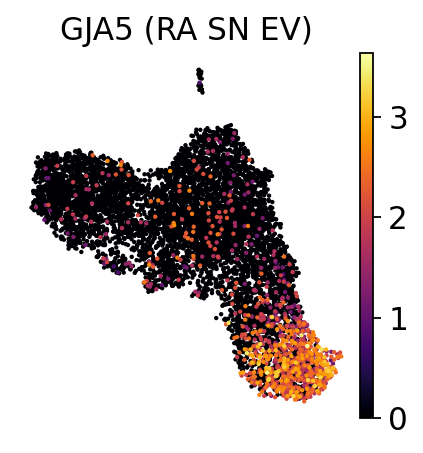

In [20]:
rcParams['figure.figsize'] = 3,3
rcParams['savefig.dpi'] = 300
sc.pl.umap(subadata, color = genes, title = genes_celltypes, frameon = False, 
                 color_map = "inferno", ncols = 3, wspace = 0.25)

AnnData object with n_obs × n_vars = 76087 × 10635
    obs: 'n_genes', 'percent_mito', 'n_counts', 'doublet_score', 'batch', 'sample_id', 'phenotype', 'leiden', 'cell_types', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'PCA_corr', 'PCA_cos', 'batch_colors', 'cell_types_colors', 'dendrogram_leiden', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase_colors', 'phenotype_colors', 'rank_genes_groups', 'sample_id_colors', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'


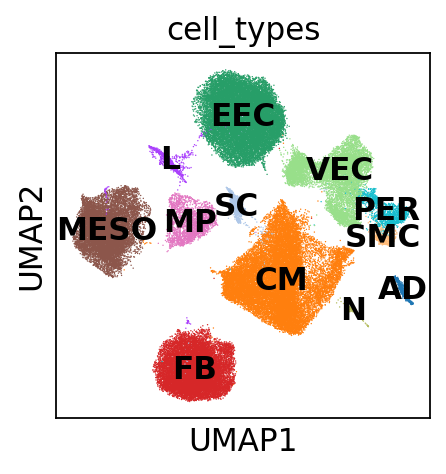

In [17]:
adata = sc.read_h5ad("../h5ad/celltypes_60_6000_500_0.1.h5ad")
print(adata)
sc.pl.umap(adata, color = 'cell_types', legend_loc = 'on data')

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


View of AnnData object with n_obs × n_vars = 1905 × 10635
    obs: 'n_genes', 'percent_mito', 'n_counts', 'doublet_score', 'batch', 'sample_id', 'phenotype', 'leiden', 'cell_types', 'S_score', 'G2M_score', 'phase', 'old_leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'PCA_corr', 'PCA_cos', 'batch_colors', 'cell_types_colors', 'dendrogram_leiden', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase_colors', 'phenotype_colors', 'rank_genes_groups', 'sample_id_colors', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'


Trying to set attribute `.var` of view, copying.


AnnData object with n_obs × n_vars = 1905 × 10635
    obs: 'n_genes', 'percent_mito', 'n_counts', 'doublet_score', 'batch', 'sample_id', 'phenotype', 'leiden', 'cell_types', 'S_score', 'G2M_score', 'phase', 'old_leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std', 'rps', 'rpl', 'mt'
    uns: 'PCA_corr', 'PCA_cos', 'batch_colors', 'cell_types_colors', 'dendrogram_leiden', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase_colors', 'phenotype_colors', 'rank_genes_groups', 'sample_id_colors', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)


2021-04-18 10:00:15,259 - harmonypy - INFO - Iteration 1 of 10
2021-04-18 10:00:16,661 - harmonypy - INFO - Iteration 2 of 10
2021-04-18 10:00:17,309 - harmonypy - INFO - Iteration 3 of 10
2021-04-18 10:00:17,629 - harmonypy - INFO - Iteration 4 of 10
2021-04-18 10:00:17,939 - harmonypy - INFO - Iteration 5 of 10
2021-04-18 10:00:18,433 - harmonypy - INFO - Iteration 6 of 10
2021-04-18 10:00:18,673 - harmonypy - INFO - Iteration 7 of 10
2021-04-18 10:00:18,850 - harmonypy - INFO - Iteration 8 of 10
2021-04-18 10:00:19,026 - harmonypy - INFO - Iteration 9 of 10
2021-04-18 10:00:19,239 - harmonypy - INFO - Iteration 10 of 10
2021-04-18 10:00:19,483 - harmonypy - INFO - Stopped before convergence


computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:04)
running Leiden clustering
    finished: found 13 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


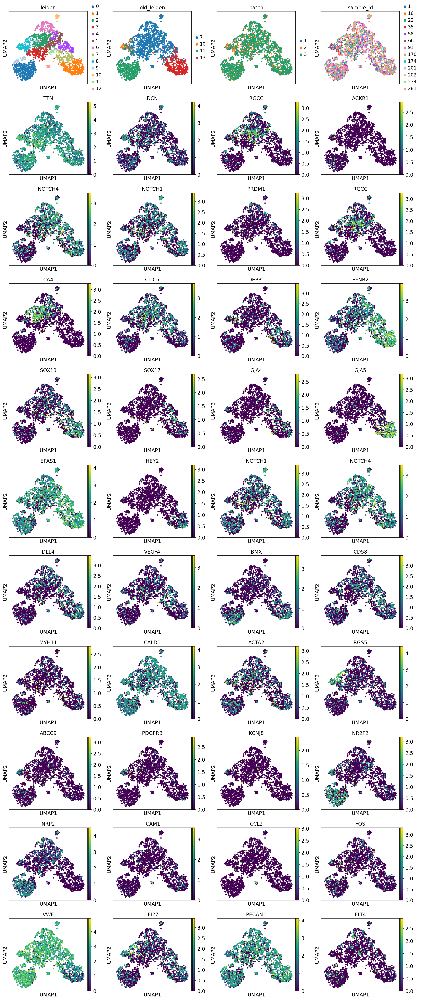

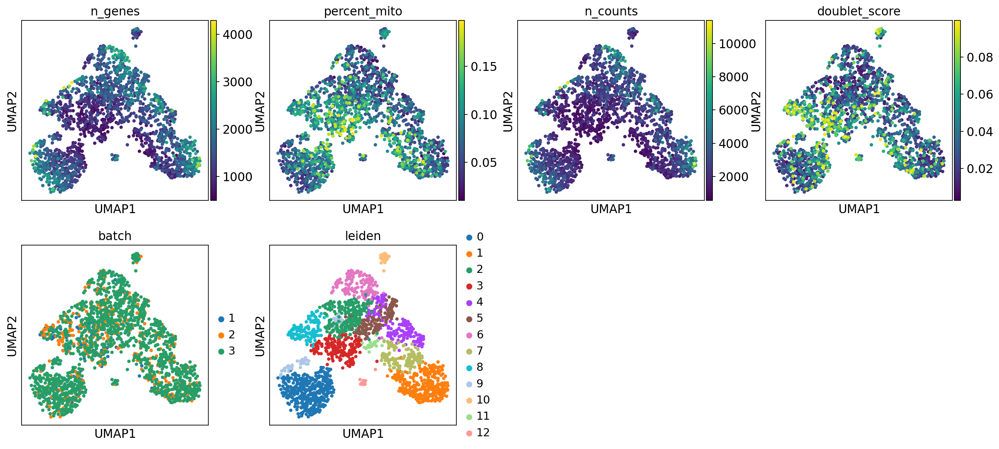

In [24]:
rcParams['figure.figsize'] = 5,5
adata.obs['old_leiden'] = adata.obs.leiden
subadata = adata[adata.obs.cell_types.isin(['VEC'])]
#subraw = sc.AnnData(subadata.raw.X.toarray(), var = subadata.raw.var, obs = subadata.obs)
#print(subraw)
#sc.pp.highly_variable_genes(subraw, min_mean=0.005, max_mean=5, min_disp=-0.25)
rcParams['figure.figsize'] = 5,5

import random
to_sel = random.sample(subadata.obs.index.to_list(), 1905)
subadata = subadata[subadata.obs.index.isin(to_sel)]
#sc.pl.highly_variable_genes(subraw)
#subraw.raw = subraw
#subraw = subraw[:, subraw.var.highly_variable]
#print(subraw)
#subadata = subraw
print(subadata)

subadata.var['rps'] = subadata.var_names.str.startswith('RPS')
subadata.var['rpl'] = subadata.var_names.str.startswith('RPL')
subadata.var['mt'] = subadata.var_names.str.startswith('MT-')
#sc.tl.rank_genes_groups(adata, 'cell_types', method='t-test', n_genes = 1000)
#df = pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(1000)
#print(list(df.loc[0:500, 'CM']))
#subadata.var['cm'] = subadata.var_names.isin(list(df.loc[0:999, 'CM']))

#subadata = subadata[:,~(subadata.var['cm'] | subadata.var['rps'] | subadata.var['rpl'] | subadata.var['mt'])]
#subadata = subadata[:,subadata.var.index.isin(subraw.var.index)]
print(subadata)
#sc.pp.regress_out(subadata, ['n_counts', 'percent_mito'])
#sc.pp.scale(subadata, max_value=10)
sc.tl.pca(subadata, svd_solver='arpack')
ho = hm.run_harmony(subadata.obsm['X_pca'], subadata.obs, "sample_id", max_iter_kmeans=50)
subadata.obsm['X_pca'] = ho.Z_corr.T
sc.pp.neighbors(subadata, n_neighbors=10, n_pcs=40)
sc.tl.umap(subadata)
sc.tl.leiden(subadata, resolution = 1)
rcParams['figure.figsize'] = 4,4
sc.pl.umap(subadata, color=['leiden', 'old_leiden', 'batch', 'sample_id', 'TTN', 'DCN', 'RGCC', 'ACKR1', 
               'NOTCH4', 'NOTCH1', 'PRDM1',
               'RGCC', 'CA4', 'CLIC5',
               "DEPP1", "EFNB2", "SOX13", "SOX17", "GJA4", "GJA5", "EPAS1", "HEY2", "NOTCH1"
                         ,"NOTCH4", "DLL4", "VEGFA", "BMX", "CD58",
               "MYH11", "CALD1", "ACTA2", 
               "RGS5", "ABCC9", "PDGFRB", "KCNJ8",
               'NR2F2', 'NRP2', 'ICAM1', 'CCL2', 'FOS',
              "VWF", "IFI27", "PECAM1", 'FLT4'])
sc.pl.umap(subadata, color = ['n_genes', 'percent_mito', 'n_counts', 'doublet_score', 'batch', 'leiden'])

In [22]:
import collections.abc as cabc
from typing import Union, Optional, Sequence, Any, Mapping, List, Tuple, Callable

import numpy as np
from anndata import AnnData
from cycler import Cycler
from matplotlib.axes import Axes
from matplotlib.figure import Figure
from pandas.api.types import is_categorical_dtype
from matplotlib import pyplot as pl, colors
from matplotlib import rcParams
from matplotlib import patheffects
from matplotlib.colors import Colormap
from functools import partial

from scanpy.plotting import _utils
from scanpy.plotting._utils import (
    _IGraphLayout,
    _FontWeight,
    _FontSize,
    circles,
    make_projection_available,
)

from scanpy import logging as logg
from scanpy._settings import settings
from scanpy._utils import sanitize_anndata, _doc_params, Empty, _empty
from scanpy._compat import Literal

VMinMax = Union[str, float, Callable[[Sequence[float]], float]]

def embedding(
    adata: AnnData,
    basis: str,
    *,
    color: Union[str, Sequence[str], None] = None,
    gene_symbols: Optional[str] = None,
    use_raw: Optional[bool] = None,
    sort_order: bool = True,
    edges: bool = False,
    edges_width: float = 0.1,
    edges_color: Union[str, Sequence[float], Sequence[str]] = 'grey',
    neighbors_key: Optional[str] = None,
    arrows: bool = False,
    arrows_kwds: Optional[Mapping[str, Any]] = None,
    groups: Optional[str] = None,
    components: Union[str, Sequence[str]] = None,
    layer: Optional[str] = None,
    projection: Literal['2d', '3d'] = '2d',
    # image parameters
    img_key: Optional[str] = None,
    crop_coord: Tuple[int, int, int, int] = None,
    alpha_img: float = 1.0,
    bw: bool = False,
    library_id: str = None,
    #
    color_map: Union[Colormap, str, None] = None,
    palette: Union[str, Sequence[str], Cycler, None] = None,
    size: Union[float, Sequence[float], None] = None,
    frameon: Optional[bool] = None,
    legend_fontsize: Union[int, float, _FontSize, None] = None,
    legend_fontweight: Union[int, _FontWeight] = 'bold',
    legend_loc: str = 'right margin',
    legend_fontoutline: Optional[int] = None,
    vmax: Union[VMinMax, Sequence[VMinMax], None] = None,
    vmin: Union[VMinMax, Sequence[VMinMax], None] = None,
    add_outline: Optional[bool] = False,
    outline_width: Tuple[float, float] = (0.3, 0.05),
    outline_color: Tuple[str, str] = ('black', 'white'),
    ncols: int = 4,
    hspace: float = 0.25,
    wspace: Optional[float] = None,
    title: Union[str, Sequence[str], None] = None,
    show: Optional[bool] = None,
    save: Union[bool, str, None] = None,
    ax: Optional[Axes] = None,
    return_fig: Optional[bool] = None,
    show_legend = True,
    **kwargs,
) -> Union[Figure, Axes, None]:
    """\
    Scatter plot for user specified embedding basis (e.g. umap, pca, etc)
    Parameters
    ----------
    basis
        Name of the `obsm` basis to use.
    {adata_color_etc}
    {edges_arrows}
    {scatter_bulk}
    {show_save_ax}
    Returns
    -------
    If `show==False` a :class:`~matplotlib.axes.Axes` or a list of it.
    """

    sanitize_anndata(adata)
    if color_map is not None:
        kwargs['cmap'] = color_map
    if size is not None:
        kwargs['s'] = size
    if 'edgecolor' not in kwargs:
        # by default turn off edge color. Otherwise, for
        # very small sizes the edge will not reduce its size
        # (https://github.com/theislab/scanpy/issues/293)
        kwargs['edgecolor'] = 'none'

    if groups:
        if isinstance(groups, str):
            groups = [groups]

    make_projection_available(projection)
    args_3d = dict(projection='3d') if projection == '3d' else {}

    # Deal with Raw
    if use_raw is None:
        # check if adata.raw is set
        use_raw = layer is None and adata.raw is not None
    if use_raw and layer is not None:
        raise ValueError(
            "Cannot use both a layer and the raw representation. Was passed:"
            f"use_raw={use_raw}, layer={layer}."
        )

    if wspace is None:
        #  try to set a wspace that is not too large or too small given the
        #  current figure size
        wspace = 0.75 / rcParams['figure.figsize'][0] + 0.02
    if adata.raw is None and use_raw:
        raise ValueError(
            "`use_raw` is set to True but AnnData object does not have raw. "
            "Please check."
        )
    # turn color into a python list
    color = [color] if isinstance(color, str) or color is None else list(color)
    if title is not None:
        # turn title into a python list if not None
        title = [title] if isinstance(title, str) else list(title)

    # get the points position and the components list
    # (only if components is not None)
    data_points, components_list = sc.pl._tools.scatterplots._get_data_points(
        adata, basis, projection, components, img_key, library_id
    )

    # Setup layout.
    # Most of the code is for the case when multiple plots are required
    # 'color' is a list of names that want to be plotted.
    # Eg. ['Gene1', 'louvain', 'Gene2'].
    # component_list is a list of components [[0,1], [1,2]]
    if (
        not isinstance(color, str)
        and isinstance(color, cabc.Sequence)
        and len(color) > 1
    ) or len(components_list) > 1:
        if ax is not None:
            raise ValueError(
                "Cannot specify `ax` when plotting multiple panels "
                "(each for a given value of 'color')."
            )
        if len(components_list) == 0:
            components_list = [None]

        # each plot needs to be its own panel
        num_panels = len(color) * len(components_list)
        fig, grid = sc.pl._tools.scatterplots._panel_grid(hspace, wspace, ncols, num_panels)
    else:
        if len(components_list) == 0:
            components_list = [None]
        grid = None
        if ax is None:
            fig = pl.figure()
            ax = fig.add_subplot(111, **args_3d)

    # turn vmax and vmin into a sequence
    if isinstance(vmax, str) or not isinstance(vmax, cabc.Sequence):
        vmax = [vmax]
    if isinstance(vmin, str) or not isinstance(vmin, cabc.Sequence):
        vmin = [vmin]

    if 's' in kwargs:
        size = kwargs.pop('s')

    if size is not None:
        # check if size is any type of sequence, and if so
        # set as ndarray
        import pandas.core.series

        if (
            size is not None
            and isinstance(
                size, (cabc.Sequence, pandas.core.series.Series, np.ndarray,)
            )
            and len(size) == adata.shape[0]
        ):
            size = np.array(size, dtype=float)
    else:
        size = 120000 / adata.shape[0]

    ###
    # make the plots
    axs = []
    import itertools

    idx_components = range(len(components_list))

    # use itertools.product to make a plot for each color and for each component
    # For example if color=[gene1, gene2] and components=['1,2, '2,3'].
    # The plots are: [
    #     color=gene1, components=[1,2], color=gene1, components=[2,3],
    #     color=gene2, components = [1, 2], color=gene2, components=[2,3],
    # ]
    for count, (value_to_plot, component_idx) in enumerate(
        itertools.product(color, idx_components)
    ):
        color_vector, categorical = sc.pl._tools.scatterplots._get_color_values(
            adata,
            value_to_plot,
            layer=layer,
            groups=groups,
            palette=palette,
            use_raw=use_raw,
            gene_symbols=gene_symbols,
        )

        # check if higher value points should be plot on top
        if sort_order is True and value_to_plot is not None and categorical is False:
            order = np.argsort(color_vector)
            color_vector = color_vector[order]
            _data_points = data_points[component_idx][order, :]

            # check if 'size' is given (stored in kwargs['s']
            # and reorder it.
            if isinstance(size, np.ndarray):
                size = np.array(size)[order]
        else:
            _data_points = data_points[component_idx]

        # if plotting multiple panels, get the ax from the grid spec
        # else use the ax value (either user given or created previously)
        if grid:
            ax = pl.subplot(grid[count], **args_3d)
            axs.append(ax)
        if not (settings._frameon if frameon is None else frameon):
            ax.axis('off')
        if title is None:
            if value_to_plot is not None:
                ax.set_title(value_to_plot)
            else:
                ax.set_title('')
        else:
            try:
                ax.set_title(title[count])
            except IndexError:
                logg.warning(
                    "The title list is shorter than the number of panels. "
                    "Using 'color' value instead for some plots."
                )
                ax.set_title(value_to_plot)

        # check vmin and vmax options
        if categorical:
            kwargs['vmin'] = kwargs['vmax'] = None
        else:
            kwargs['vmin'], kwargs['vmax'] = sc.pl._tools.scatterplots._get_vmin_vmax(
                vmin, vmax, count, color_vector
            )

        # make the scatter plot
        if projection == '3d':
            cax = ax.scatter(
                _data_points[:, 0],
                _data_points[:, 1],
                _data_points[:, 2],
                marker=".",
                c=color_vector,
                rasterized=settings._vector_friendly,
                **kwargs,
            )
        else:
            if img_key is not None:
                # had to return size_spot cause spot size is set according
                # to the image to be plotted
                img_processed, img_coord, size_spot, cmap_img = _process_image(
                    adata, data_points, img_key, crop_coord, size, library_id, bw
                )
                ax.imshow(img_processed, cmap=cmap_img, alpha=alpha_img)
                ax.set_xlim(img_coord[0], img_coord[1])
                ax.set_ylim(img_coord[3], img_coord[2])
            elif img_key is None and library_id is not None:
                # order of magnitude similar to public visium
                size_spot = 70 * size

            scatter = (
                partial(ax.scatter, s=size)
                if library_id is None
                else partial(circles, s=size_spot, ax=ax)
            )

            if add_outline:
                # the default outline is a black edge followed by a
                # thin white edged added around connected clusters.
                # To add an outline
                # three overlapping scatter plots are drawn:
                # First black dots with slightly larger size,
                # then, white dots a bit smaller, but still larger
                # than the final dots. Then the final dots are drawn
                # with some transparency.

                bg_width, gap_width = outline_width
                point = np.sqrt(size)
                gap_size = (point + (point * gap_width) * 2) ** 2
                bg_size = (np.sqrt(gap_size) + (point * bg_width) * 2) ** 2
                # the default black and white colors can be changes using
                # the contour_config parameter
                bg_color, gap_color = outline_color

                # remove edge from kwargs if present
                # because edge needs to be set to None
                kwargs['edgecolor'] = 'none'

                # remove alpha for outline
                alpha = kwargs.pop('alpha') if 'alpha' in kwargs else None

                ax.scatter(
                    _data_points[:, 0],
                    _data_points[:, 1],
                    s=bg_size,
                    marker=".",
                    c=bg_color,
                    rasterized=settings._vector_friendly,
                    **kwargs,
                )
                ax.scatter(
                    _data_points[:, 0],
                    _data_points[:, 1],
                    s=gap_size,
                    marker=".",
                    c=gap_color,
                    rasterized=settings._vector_friendly,
                    **kwargs,
                )
                # if user did not set alpha, set alpha to 0.7
                kwargs['alpha'] = 0.7 if alpha is None else alpha

            if groups:
                # first plot non-groups and then plot the
                # required groups on top

                in_groups = np.array(adata.obs[value_to_plot].isin(groups))

                if isinstance(size, np.ndarray):
                    in_groups_size = size[in_groups]
                    not_in_groups_size = size[~in_groups]
                elif img_key is not None:
                    in_groups_size = not_in_groups_size = size_spot
                else:
                    in_groups_size = not_in_groups_size = size

                # only show grey points if no image is below
                if library_id is None:
                    ax.scatter(
                        _data_points[~in_groups, 0],
                        _data_points[~in_groups, 1],
                        s=not_in_groups_size,
                        marker=".",
                        c=color_vector[~in_groups],
                        rasterized=settings._vector_friendly,
                        **kwargs,
                    )
                cax = scatter(
                    _data_points[in_groups, 0],
                    _data_points[in_groups, 1],
                    s=in_groups_size,
                    marker=".",
                    c=color_vector[in_groups],
                    rasterized=settings._vector_friendly,
                    **kwargs,
                )

            else:
                cax = scatter(
                    _data_points[:, 0],
                    _data_points[:, 1],
                    marker=".",
                    c=color_vector,
                    rasterized=settings._vector_friendly,
                    **kwargs,
                )

        # remove y and x ticks
        ax.set_yticks([])
        ax.set_xticks([])
        if projection == '3d':
            ax.set_zticks([])

        # set default axis_labels
        name = sc.pl._tools.scatterplots._basis2name(basis)
        if components is not None:
            axis_labels = [name + str(x + 1) for x in components_list[component_idx]]
        elif projection == '3d':
            axis_labels = [name + str(x + 1) for x in range(3)]

        else:
            axis_labels = [name + str(x + 1) for x in range(2)]

        ax.set_xlabel(axis_labels[0])
        ax.set_ylabel(axis_labels[1])
        if projection == '3d':
            # shift the label closer to the axis
            ax.set_zlabel(axis_labels[2], labelpad=-7)
        ax.autoscale_view()

        if edges:
            _utils.plot_edges(ax, adata, basis, edges_width, edges_color, neighbors_key)
        if arrows:
            _utils.plot_arrows(ax, adata, basis, arrows_kwds)

        if value_to_plot is None:
            # if only dots were plotted without an associated value
            # there is not need to plot a legend or a colorbar
            continue

        if legend_fontoutline is not None:
            path_effect = [
                patheffects.withStroke(linewidth=legend_fontoutline, foreground='w',)
            ]
        else:
            path_effect = None
        
        if show_legend:
            sc.pl._tools.scatterplots._add_legend_or_colorbar(
                adata,
                ax,
                cax,
                categorical,
                value_to_plot,
                legend_loc,
                _data_points,
                legend_fontweight,
                legend_fontsize,
                path_effect,
                groups,
                bool(grid),
            )

    if return_fig is True:
        return fig
    axs = axs if grid else ax
    _utils.savefig_or_show(basis, show=show, save=save)
    if show is False:
        return axs

    
def umap(adata, **kwargs) -> Union[Axes, List[Axes], None]:
    """\
    Scatter plot in UMAP basis.
    Parameters
    ----------
    {adata_color_etc}
    {edges_arrows}
    {scatter_bulk}
    {show_save_ax}
    Returns
    -------
    If `show==False` a :class:`~matplotlib.axes.Axes` or a list of it.
    """
    return embedding(adata, 'umap', **kwargs)

In [25]:
genes = ['CA4', 'RGCC', 'NR2F2', 'EFNB2', 'HEY2', 'SOX17', 'GJA5', 'EFNA5', 'BMX']
genes_celltypes = ['CA4 (Capillary)', 'RGCC (Capillary)', 'NR2F2 (Venous)', 'EFNB2 (Arterial)', 
                   'HEY2 (Coronary Artery)', 'SOX17 (Arterial)', 'GJA5 (Coronary Artery)', 
                   'EFNA5 (Coronary Artery)', 'BMX (Coronary Artery)']

In [26]:
genes = ['HEY2', 'GJA5', 'EFNA5']
genes_celltypes = ['HEY2 (Coronary artery)', 'GJA5 (Coronary artery)', 'EFNA5 (Coronary artery)']

In [27]:
subadata

AnnData object with n_obs × n_vars = 1905 × 10635
    obs: 'n_genes', 'percent_mito', 'n_counts', 'doublet_score', 'batch', 'sample_id', 'phenotype', 'leiden', 'cell_types', 'S_score', 'G2M_score', 'phase', 'old_leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std', 'rps', 'rpl', 'mt'
    uns: 'PCA_corr', 'PCA_cos', 'batch_colors', 'cell_types_colors', 'dendrogram_leiden', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase_colors', 'phenotype_colors', 'rank_genes_groups', 'sample_id_colors', 'umap', 'old_leiden_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

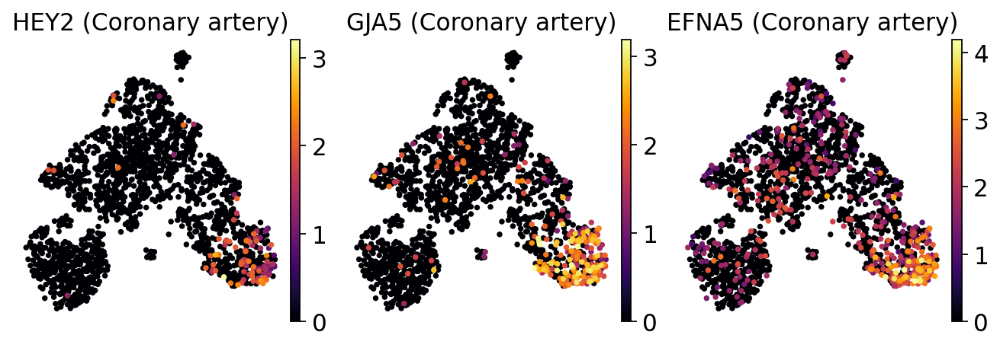

In [28]:
rcParams['figure.figsize'] = 3,3
rcParams['savefig.dpi'] = 300
sc.pl.umap(subadata, color = genes, title = genes_celltypes, frameon = False, 
                 color_map = "inferno", ncols = 3, wspace = 0.1, size = 45)

In [29]:
subadata.write("../h5ad/subadata_SN_RA_EV_VEC_Subsampled.h5ad")

/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


View of AnnData object with n_obs × n_vars = 9659 × 10635
    obs: 'n_genes', 'percent_mito', 'n_counts', 'doublet_score', 'batch', 'sample_id', 'phenotype', 'leiden', 'cell_types', 'S_score', 'G2M_score', 'phase', 'old_leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'PCA_corr', 'PCA_cos', 'batch_colors', 'cell_types_colors', 'dendrogram_leiden', 'leiden', 'neighbors', 'pca', 'phase_colors', 'phenotype_colors', 'rank_genes_groups', 'sample_id_colors', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'


Trying to set attribute `.var` of view, copying.


ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)
AnnData object with n_obs × n_vars = 9659 × 10635
    obs: 'n_genes', 'percent_mito', 'n_counts', 'doublet_score', 'batch', 'sample_id', 'phenotype', 'leiden', 'cell_types', 'S_score', 'G2M_score', 'phase', 'old_leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std', 'rps', 'rpl', 'mt', 'cm'
    uns: 'PCA_corr', 'PCA_cos', 'batch_colors', 'cell_types_colors', 'dendrogram_leiden', 'leiden', 'neighbors', 'pca', 'phase_colors', 'phenotype_colors', 'rank_genes_groups', 'sample_id_colors', 'umap'
    obsm: 'X_pca', 'X_tsne', '

2020-12-16 16:40:11,757 - harmonypy - INFO - Iteration 1 of 10
2020-12-16 16:40:17,633 - harmonypy - INFO - Iteration 2 of 10
2020-12-16 16:40:21,724 - harmonypy - INFO - Iteration 3 of 10
2020-12-16 16:40:23,811 - harmonypy - INFO - Iteration 4 of 10
2020-12-16 16:40:26,008 - harmonypy - INFO - Converged after 4 iterations


computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:17)
running Leiden clustering
    finished: found 13 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


/home/schmauch/data/conda/envs/project3/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


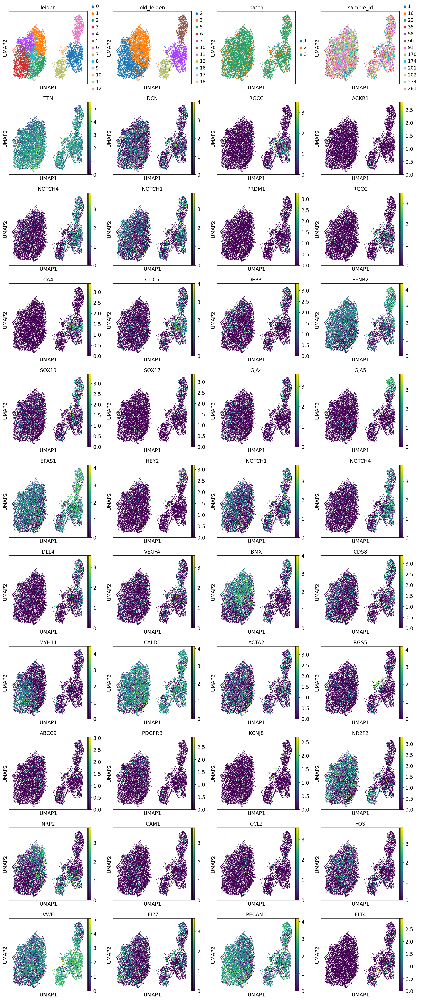

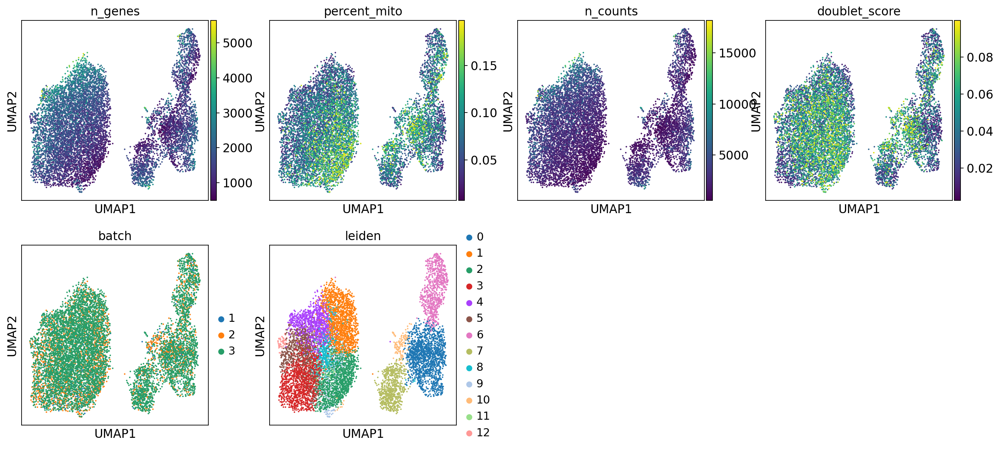

In [37]:
adata.obs['old_leiden'] = adata.obs.leiden
subadata = adata[adata.obs.cell_types.isin(['VEC', 'EEC'])]
#subraw = sc.AnnData(subadata.raw.X.toarray(), var = subadata.raw.var, obs = subadata.obs)
#print(subraw)
#sc.pp.highly_variable_genes(subraw, min_mean=0.005, max_mean=5, min_disp=-0.25)
rcParams['figure.figsize'] = 5,5
#sc.pl.highly_variable_genes(subraw)
#subraw.raw = subraw
#subraw = subraw[:, subraw.var.highly_variable]
#print(subraw)
#subadata = subraw
print(subadata)

subadata.var['rps'] = subadata.var_names.str.startswith('RPS')
subadata.var['rpl'] = subadata.var_names.str.startswith('RPL')
subadata.var['mt'] = subadata.var_names.str.startswith('MT-')
sc.tl.rank_genes_groups(adata, 'cell_types', method='t-test', n_genes = 1000)
df = pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(1000)
#print(list(df.loc[0:500, 'CM']))
subadata.var['cm'] = subadata.var_names.isin(list(df.loc[0:999, 'CM']))

#subadata = subadata[:,~(subadata.var['cm'] | subadata.var['rps'] | subadata.var['rpl'] | subadata.var['mt'])]
#subadata = subadata[:,subadata.var.index.isin(subraw.var.index)]
print(subadata)
#sc.pp.regress_out(subadata, ['n_counts', 'percent_mito'])
#sc.pp.scale(subadata, max_value=10)
sc.tl.pca(subadata, svd_solver='arpack')
ho = hm.run_harmony(subadata.obsm['X_pca'], subadata.obs, "sample_id", max_iter_kmeans=50)
subadata.obsm['X_pca'] = ho.Z_corr.T
sc.pp.neighbors(subadata, n_neighbors=10, n_pcs=40)
sc.tl.umap(subadata)
sc.tl.leiden(subadata, resolution = 1)
rcParams['figure.figsize'] = 4,4
sc.pl.umap(subadata, color=['leiden', 'old_leiden', 'batch', 'sample_id', 'TTN', 'DCN', 'RGCC', 'ACKR1', 
               'NOTCH4', 'NOTCH1', 'PRDM1',
               'RGCC', 'CA4', 'CLIC5',
               "DEPP1", "EFNB2", "SOX13", "SOX17", "GJA4", "GJA5", "EPAS1", "HEY2", "NOTCH1"
                         ,"NOTCH4", "DLL4", "VEGFA", "BMX", "CD58",
               "MYH11", "CALD1", "ACTA2", 
               "RGS5", "ABCC9", "PDGFRB", "KCNJ8",
               'NR2F2', 'NRP2', 'ICAM1', 'CCL2', 'FOS',
              "VWF", "IFI27", "PECAM1", 'FLT4'])
sc.pl.umap(subadata, color = ['n_genes', 'percent_mito', 'n_counts', 'doublet_score', 'batch', 'leiden'])

In [38]:
import collections.abc as cabc
from typing import Union, Optional, Sequence, Any, Mapping, List, Tuple, Callable

import numpy as np
from anndata import AnnData
from cycler import Cycler
from matplotlib.axes import Axes
from matplotlib.figure import Figure
from pandas.api.types import is_categorical_dtype
from matplotlib import pyplot as pl, colors
from matplotlib import rcParams
from matplotlib import patheffects
from matplotlib.colors import Colormap
from functools import partial

from scanpy.plotting import _utils
from scanpy.plotting._utils import (
    _IGraphLayout,
    _FontWeight,
    _FontSize,
    circles,
    make_projection_available,
)

from scanpy import logging as logg
from scanpy._settings import settings
from scanpy._utils import sanitize_anndata, _doc_params, Empty, _empty
from scanpy._compat import Literal

VMinMax = Union[str, float, Callable[[Sequence[float]], float]]

def embedding(
    adata: AnnData,
    basis: str,
    *,
    color: Union[str, Sequence[str], None] = None,
    gene_symbols: Optional[str] = None,
    use_raw: Optional[bool] = None,
    sort_order: bool = True,
    edges: bool = False,
    edges_width: float = 0.1,
    edges_color: Union[str, Sequence[float], Sequence[str]] = 'grey',
    neighbors_key: Optional[str] = None,
    arrows: bool = False,
    arrows_kwds: Optional[Mapping[str, Any]] = None,
    groups: Optional[str] = None,
    components: Union[str, Sequence[str]] = None,
    layer: Optional[str] = None,
    projection: Literal['2d', '3d'] = '2d',
    # image parameters
    img_key: Optional[str] = None,
    crop_coord: Tuple[int, int, int, int] = None,
    alpha_img: float = 1.0,
    bw: bool = False,
    library_id: str = None,
    #
    color_map: Union[Colormap, str, None] = None,
    palette: Union[str, Sequence[str], Cycler, None] = None,
    size: Union[float, Sequence[float], None] = None,
    frameon: Optional[bool] = None,
    legend_fontsize: Union[int, float, _FontSize, None] = None,
    legend_fontweight: Union[int, _FontWeight] = 'bold',
    legend_loc: str = 'right margin',
    legend_fontoutline: Optional[int] = None,
    vmax: Union[VMinMax, Sequence[VMinMax], None] = None,
    vmin: Union[VMinMax, Sequence[VMinMax], None] = None,
    add_outline: Optional[bool] = False,
    outline_width: Tuple[float, float] = (0.3, 0.05),
    outline_color: Tuple[str, str] = ('black', 'white'),
    ncols: int = 4,
    hspace: float = 0.25,
    wspace: Optional[float] = None,
    title: Union[str, Sequence[str], None] = None,
    show: Optional[bool] = None,
    save: Union[bool, str, None] = None,
    ax: Optional[Axes] = None,
    return_fig: Optional[bool] = None,
    show_legend = True,
    **kwargs,
) -> Union[Figure, Axes, None]:
    """\
    Scatter plot for user specified embedding basis (e.g. umap, pca, etc)
    Parameters
    ----------
    basis
        Name of the `obsm` basis to use.
    {adata_color_etc}
    {edges_arrows}
    {scatter_bulk}
    {show_save_ax}
    Returns
    -------
    If `show==False` a :class:`~matplotlib.axes.Axes` or a list of it.
    """

    sanitize_anndata(adata)
    if color_map is not None:
        kwargs['cmap'] = color_map
    if size is not None:
        kwargs['s'] = size
    if 'edgecolor' not in kwargs:
        # by default turn off edge color. Otherwise, for
        # very small sizes the edge will not reduce its size
        # (https://github.com/theislab/scanpy/issues/293)
        kwargs['edgecolor'] = 'none'

    if groups:
        if isinstance(groups, str):
            groups = [groups]

    make_projection_available(projection)
    args_3d = dict(projection='3d') if projection == '3d' else {}

    # Deal with Raw
    if use_raw is None:
        # check if adata.raw is set
        use_raw = layer is None and adata.raw is not None
    if use_raw and layer is not None:
        raise ValueError(
            "Cannot use both a layer and the raw representation. Was passed:"
            f"use_raw={use_raw}, layer={layer}."
        )

    if wspace is None:
        #  try to set a wspace that is not too large or too small given the
        #  current figure size
        wspace = 0.75 / rcParams['figure.figsize'][0] + 0.02
    if adata.raw is None and use_raw:
        raise ValueError(
            "`use_raw` is set to True but AnnData object does not have raw. "
            "Please check."
        )
    # turn color into a python list
    color = [color] if isinstance(color, str) or color is None else list(color)
    if title is not None:
        # turn title into a python list if not None
        title = [title] if isinstance(title, str) else list(title)

    # get the points position and the components list
    # (only if components is not None)
    data_points, components_list = sc.pl._tools.scatterplots._get_data_points(
        adata, basis, projection, components, img_key, library_id
    )

    # Setup layout.
    # Most of the code is for the case when multiple plots are required
    # 'color' is a list of names that want to be plotted.
    # Eg. ['Gene1', 'louvain', 'Gene2'].
    # component_list is a list of components [[0,1], [1,2]]
    if (
        not isinstance(color, str)
        and isinstance(color, cabc.Sequence)
        and len(color) > 1
    ) or len(components_list) > 1:
        if ax is not None:
            raise ValueError(
                "Cannot specify `ax` when plotting multiple panels "
                "(each for a given value of 'color')."
            )
        if len(components_list) == 0:
            components_list = [None]

        # each plot needs to be its own panel
        num_panels = len(color) * len(components_list)
        fig, grid = sc.pl._tools.scatterplots._panel_grid(hspace, wspace, ncols, num_panels)
    else:
        if len(components_list) == 0:
            components_list = [None]
        grid = None
        if ax is None:
            fig = pl.figure()
            ax = fig.add_subplot(111, **args_3d)

    # turn vmax and vmin into a sequence
    if isinstance(vmax, str) or not isinstance(vmax, cabc.Sequence):
        vmax = [vmax]
    if isinstance(vmin, str) or not isinstance(vmin, cabc.Sequence):
        vmin = [vmin]

    if 's' in kwargs:
        size = kwargs.pop('s')

    if size is not None:
        # check if size is any type of sequence, and if so
        # set as ndarray
        import pandas.core.series

        if (
            size is not None
            and isinstance(
                size, (cabc.Sequence, pandas.core.series.Series, np.ndarray,)
            )
            and len(size) == adata.shape[0]
        ):
            size = np.array(size, dtype=float)
    else:
        size = 120000 / adata.shape[0]

    ###
    # make the plots
    axs = []
    import itertools

    idx_components = range(len(components_list))

    # use itertools.product to make a plot for each color and for each component
    # For example if color=[gene1, gene2] and components=['1,2, '2,3'].
    # The plots are: [
    #     color=gene1, components=[1,2], color=gene1, components=[2,3],
    #     color=gene2, components = [1, 2], color=gene2, components=[2,3],
    # ]
    for count, (value_to_plot, component_idx) in enumerate(
        itertools.product(color, idx_components)
    ):
        color_vector, categorical = sc.pl._tools.scatterplots._get_color_values(
            adata,
            value_to_plot,
            layer=layer,
            groups=groups,
            palette=palette,
            use_raw=use_raw,
            gene_symbols=gene_symbols,
        )

        # check if higher value points should be plot on top
        if sort_order is True and value_to_plot is not None and categorical is False:
            order = np.argsort(color_vector)
            color_vector = color_vector[order]
            _data_points = data_points[component_idx][order, :]

            # check if 'size' is given (stored in kwargs['s']
            # and reorder it.
            if isinstance(size, np.ndarray):
                size = np.array(size)[order]
        else:
            _data_points = data_points[component_idx]

        # if plotting multiple panels, get the ax from the grid spec
        # else use the ax value (either user given or created previously)
        if grid:
            ax = pl.subplot(grid[count], **args_3d)
            axs.append(ax)
        if not (settings._frameon if frameon is None else frameon):
            ax.axis('off')
        if title is None:
            if value_to_plot is not None:
                ax.set_title(value_to_plot)
            else:
                ax.set_title('')
        else:
            try:
                ax.set_title(title[count])
            except IndexError:
                logg.warning(
                    "The title list is shorter than the number of panels. "
                    "Using 'color' value instead for some plots."
                )
                ax.set_title(value_to_plot)

        # check vmin and vmax options
        if categorical:
            kwargs['vmin'] = kwargs['vmax'] = None
        else:
            kwargs['vmin'], kwargs['vmax'] = sc.pl._tools.scatterplots._get_vmin_vmax(
                vmin, vmax, count, color_vector
            )

        # make the scatter plot
        if projection == '3d':
            cax = ax.scatter(
                _data_points[:, 0],
                _data_points[:, 1],
                _data_points[:, 2],
                marker=".",
                c=color_vector,
                rasterized=settings._vector_friendly,
                **kwargs,
            )
        else:
            if img_key is not None:
                # had to return size_spot cause spot size is set according
                # to the image to be plotted
                img_processed, img_coord, size_spot, cmap_img = _process_image(
                    adata, data_points, img_key, crop_coord, size, library_id, bw
                )
                ax.imshow(img_processed, cmap=cmap_img, alpha=alpha_img)
                ax.set_xlim(img_coord[0], img_coord[1])
                ax.set_ylim(img_coord[3], img_coord[2])
            elif img_key is None and library_id is not None:
                # order of magnitude similar to public visium
                size_spot = 70 * size

            scatter = (
                partial(ax.scatter, s=size)
                if library_id is None
                else partial(circles, s=size_spot, ax=ax)
            )

            if add_outline:
                # the default outline is a black edge followed by a
                # thin white edged added around connected clusters.
                # To add an outline
                # three overlapping scatter plots are drawn:
                # First black dots with slightly larger size,
                # then, white dots a bit smaller, but still larger
                # than the final dots. Then the final dots are drawn
                # with some transparency.

                bg_width, gap_width = outline_width
                point = np.sqrt(size)
                gap_size = (point + (point * gap_width) * 2) ** 2
                bg_size = (np.sqrt(gap_size) + (point * bg_width) * 2) ** 2
                # the default black and white colors can be changes using
                # the contour_config parameter
                bg_color, gap_color = outline_color

                # remove edge from kwargs if present
                # because edge needs to be set to None
                kwargs['edgecolor'] = 'none'

                # remove alpha for outline
                alpha = kwargs.pop('alpha') if 'alpha' in kwargs else None

                ax.scatter(
                    _data_points[:, 0],
                    _data_points[:, 1],
                    s=bg_size,
                    marker=".",
                    c=bg_color,
                    rasterized=settings._vector_friendly,
                    **kwargs,
                )
                ax.scatter(
                    _data_points[:, 0],
                    _data_points[:, 1],
                    s=gap_size,
                    marker=".",
                    c=gap_color,
                    rasterized=settings._vector_friendly,
                    **kwargs,
                )
                # if user did not set alpha, set alpha to 0.7
                kwargs['alpha'] = 0.7 if alpha is None else alpha

            if groups:
                # first plot non-groups and then plot the
                # required groups on top

                in_groups = np.array(adata.obs[value_to_plot].isin(groups))

                if isinstance(size, np.ndarray):
                    in_groups_size = size[in_groups]
                    not_in_groups_size = size[~in_groups]
                elif img_key is not None:
                    in_groups_size = not_in_groups_size = size_spot
                else:
                    in_groups_size = not_in_groups_size = size

                # only show grey points if no image is below
                if library_id is None:
                    ax.scatter(
                        _data_points[~in_groups, 0],
                        _data_points[~in_groups, 1],
                        s=not_in_groups_size,
                        marker=".",
                        c=color_vector[~in_groups],
                        rasterized=settings._vector_friendly,
                        **kwargs,
                    )
                cax = scatter(
                    _data_points[in_groups, 0],
                    _data_points[in_groups, 1],
                    s=in_groups_size,
                    marker=".",
                    c=color_vector[in_groups],
                    rasterized=settings._vector_friendly,
                    **kwargs,
                )

            else:
                cax = scatter(
                    _data_points[:, 0],
                    _data_points[:, 1],
                    marker=".",
                    c=color_vector,
                    rasterized=settings._vector_friendly,
                    **kwargs,
                )

        # remove y and x ticks
        ax.set_yticks([])
        ax.set_xticks([])
        if projection == '3d':
            ax.set_zticks([])

        # set default axis_labels
        name = sc.pl._tools.scatterplots._basis2name(basis)
        if components is not None:
            axis_labels = [name + str(x + 1) for x in components_list[component_idx]]
        elif projection == '3d':
            axis_labels = [name + str(x + 1) for x in range(3)]

        else:
            axis_labels = [name + str(x + 1) for x in range(2)]

        ax.set_xlabel(axis_labels[0])
        ax.set_ylabel(axis_labels[1])
        if projection == '3d':
            # shift the label closer to the axis
            ax.set_zlabel(axis_labels[2], labelpad=-7)
        ax.autoscale_view()

        if edges:
            _utils.plot_edges(ax, adata, basis, edges_width, edges_color, neighbors_key)
        if arrows:
            _utils.plot_arrows(ax, adata, basis, arrows_kwds)

        if value_to_plot is None:
            # if only dots were plotted without an associated value
            # there is not need to plot a legend or a colorbar
            continue

        if legend_fontoutline is not None:
            path_effect = [
                patheffects.withStroke(linewidth=legend_fontoutline, foreground='w',)
            ]
        else:
            path_effect = None
        
        if show_legend:
            sc.pl._tools.scatterplots._add_legend_or_colorbar(
                adata,
                ax,
                cax,
                categorical,
                value_to_plot,
                legend_loc,
                _data_points,
                legend_fontweight,
                legend_fontsize,
                path_effect,
                groups,
                bool(grid),
            )

    if return_fig is True:
        return fig
    axs = axs if grid else ax
    _utils.savefig_or_show(basis, show=show, save=save)
    if show is False:
        return axs

    
def umap(adata, **kwargs) -> Union[Axes, List[Axes], None]:
    """\
    Scatter plot in UMAP basis.
    Parameters
    ----------
    {adata_color_etc}
    {edges_arrows}
    {scatter_bulk}
    {show_save_ax}
    Returns
    -------
    If `show==False` a :class:`~matplotlib.axes.Axes` or a list of it.
    """
    return embedding(adata, 'umap', **kwargs)

In [39]:
genes = ['PECAM1', 'VWF', 'NFATC1', 'NPR3']
genes_celltypes = ['PECAM1 (EC)', 'VWF (VEC)', 'NFATC1 (EEC)', 'NPR3 (EEC)']

In [40]:
subadata

AnnData object with n_obs × n_vars = 9659 × 10635
    obs: 'n_genes', 'percent_mito', 'n_counts', 'doublet_score', 'batch', 'sample_id', 'phenotype', 'leiden', 'cell_types', 'S_score', 'G2M_score', 'phase', 'old_leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std', 'rps', 'rpl', 'mt', 'cm'
    uns: 'PCA_corr', 'PCA_cos', 'batch_colors', 'cell_types_colors', 'dendrogram_leiden', 'leiden', 'neighbors', 'pca', 'phase_colors', 'phenotype_colors', 'rank_genes_groups', 'sample_id_colors', 'umap', 'leiden_colors', 'old_leiden_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

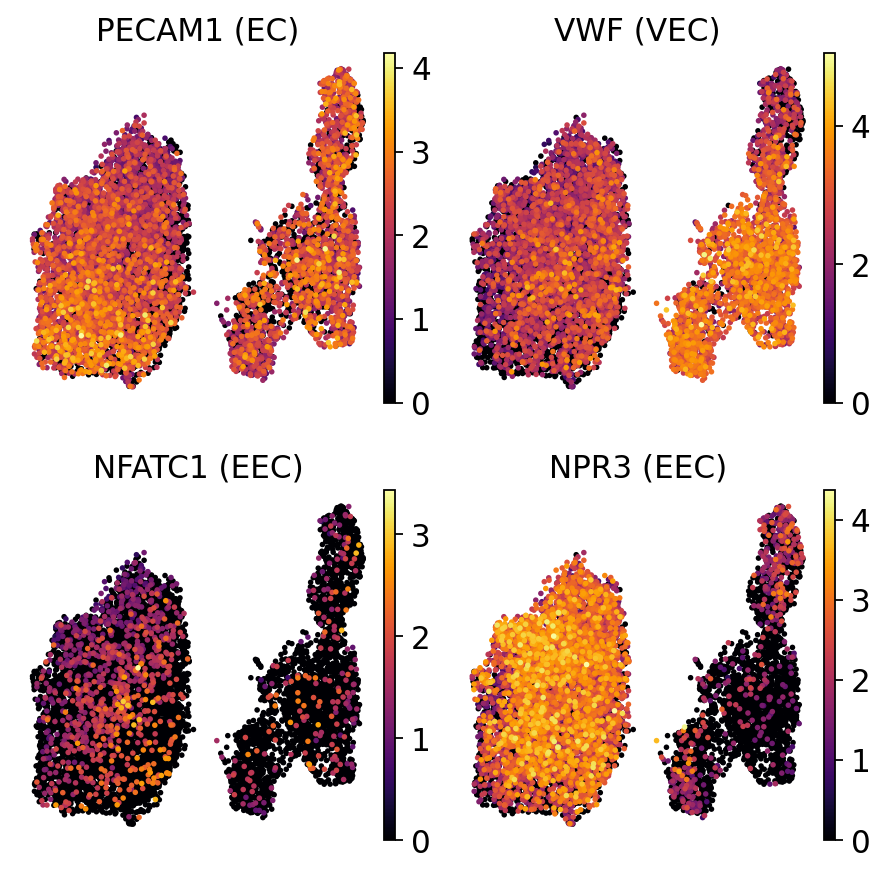

In [45]:
rcParams['figure.figsize'] = 3,3
rcParams['savefig.dpi'] = 300
sc.pl.umap(subadata, color = genes, title = genes_celltypes, frameon = False, size = 25,
                 color_map = "inferno", ncols = 2, wspace = 0.10)